In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from SlideRunner_dataAccess.database import Database
from pathlib import Path
import matplotlib.pyplot as plt
import numpy as np
import openslide
import pandas as pd
import pyvips
import os
import re

In [3]:
# set directories
root = Path.home() 
data_dir = Path('/data/department/aubreville/datasets/TMAs')
proj_dir = root / 'projects/Cox_AMIL'
database = root / 'projects/Cox_AMIL/tma_databases/Ostercappeln_Ki67.sqlite'

## Load and filter database

In [4]:
DB = Database().open(str(database))

# join annoId with classes 
get_cores = 'SELECT Classes.uid, Classes.name, Annotations_label.annoId FROM Classes LEFT JOIN Annotations_label ON Classes.uid=Annotations_label.class'
cores = pd.DataFrame(DB.execute(get_cores).fetchall(), columns=['core_id', 'core_label', 'anno_id'])

# get coordinates
get_coords = 'SELECT annoId, coordinateX, coordinateY, Annotations_coordinates.slide FROM Annotations_coordinates LEFT JOIN Annotations ON Annotations_coordinates.annoId=Annotations.uid WHERE Annotations.deleted=0'
coords = pd.DataFrame(DB.execute(get_coords), columns=['anno_id', 'x', 'y', 'slide_id'])

# join cores and coords
df = pd.merge(cores, coords, how='inner', on='anno_id')

# get slides
get_slides = 'SELECT uid, filename, directory FROM Slides'
slides = pd.DataFrame(DB.execute(get_slides), columns=['slide_id', 'filename', 'dir'])

# ============================================ #
#TODO: Change location and filenames to remove these manual steps!!!
# change directories
dirs = [str(data_dir)] * 2 + [os.path.join(data_dir, 'Delivery3')] * 5
slides = slides.assign(dir=dirs)

# add level 
level = [1] * 2 + [0] * 5
slides = slides.assign(level=level)

# add patient_id
patient_ids = [int(re.split('P|_', s)[1]) for s in df.core_label]
df = df.assign(patient_id=patient_ids)
# ============================================ #

In [5]:
df.head()

,core_id,core_label,anno_id,x,y,slide_id,patient_id
0,1,P1_1,1093.0,32567,202513,4,1
1,1,P1_1,1093.0,32571,202517,4,1
2,1,P1_1,1093.0,32571,202521,4,1
3,1,P1_1,1093.0,32579,202521,4,1
4,1,P1_1,1093.0,32583,202517,4,1


In [6]:
slides

,slide_id,filename,dir,level
0,1,DigitalSlide_A1M_2S_1.mrxs,/data/department/aubreville/datasets/TMAs,1
1,2,DigitalSlide_A1M_4S_1.mrxs,/data/department/aubreville/datasets/TMAs,1
2,3,Lungen_CA_1.mrxs,/data/department/aubreville/datasets/TMAs/Deli...,0
3,4,Lungen_TMA_1b.mrxs,/data/department/aubreville/datasets/TMAs/Deli...,0
4,5,Lungen_CA_2.mrxs,/data/department/aubreville/datasets/TMAs/Deli...,0
5,6,Lungen_TMB_3.mrxs,/data/department/aubreville/datasets/TMAs/Deli...,0
6,7,Lungen_CA_3b.mrxs,/data/department/aubreville/datasets/TMAs/Deli...,0


## A few sanity checks


In [7]:
import sys
sys.path.append('..')

from tma_utils.tma_utils import check_coreID_range, check_patientID_range

In [8]:
check_patientID_range(slide_id=1, low=151, high=303, df=df)

slide_id 1: True


In [9]:
check_patientID_range(slide_id=2, low=1, high=150, df=df)

slide_id 2: True


In [10]:
check_patientID_range(slide_id=3, low=1, high=150, df=df)

slide_id 3: True


In [11]:
check_patientID_range(slide_id=4, low=1, high=150, df=df)

slide_id 4: True


In [12]:
check_patientID_range(slide_id=5, low=151, high=303, df=df)

slide_id 5: True


In [13]:
check_patientID_range(slide_id=6, low=304, high=394, df=df)

slide_id 6: True


In [14]:
check_patientID_range(slide_id=7, low=304, high=394, df=df)

slide_id 7: True


In [15]:
MIN = 1000
MAX = 7000
for slide_id in df.slide_id.unique():
    x_range, y_range, too_big, too_small = check_coreID_range(slide_id=slide_id, df=df, min=MIN, max=MAX, verbose=True)
    print('\nSlide {}: median x {}, median y {}\n'.format(slide_id, np.median(x_range), np.median(y_range)))
    print('='*50)


Slide 4 without suspicously large core annotations.

Slide 4 with 1 suspicously small core annotations.
Core 426, x_range 989, y_range 2407

Slide 4: median x 2662.0, median y 2723.5


Slide 2 with 2 suspicously large core annotations.
Core 135, x_range 7902, y_range 5499
Core 195, x_range 7827, y_range 5478

Slide 2 without suspicously small core annotations.

Slide 2: median x 5139.0, median y 5351.0


Slide 3 without suspicously large core annotations.

Slide 3 without suspicously small core annotations.

Slide 3: median x 2586.0, median y 2575.0


Slide 5 without suspicously large core annotations.

Slide 5 without suspicously small core annotations.

Slide 5: median x 2519.0, median y 2576.0


Slide 1 with 23 suspicously large core annotations.
Core 559, x_range 7041, y_range 7413
Core 566, x_range 6173, y_range 7309
Core 574, x_range 6211, y_range 7451
Core 576, x_range 6678, y_range 7156
Core 592, x_range 6469, y_range 7156
Core 597, x_range 6554, y_range 7308
Core 604, x_range

### Visualize suspicous cases 

In [16]:
from tma_utils.tma_utils import extract_core

def show_core(slide: openslide.OpenSlide, 
              df: pd.DataFrame, 
              level: int=0,
              core_id:int=None, 
              core_name: str=None, 
              figsize: tuple=(10, 10)) -> None:

    core = extract_core(slide, df, level, core_id, core_name)
    
    if core is not None:
        plt.figure(figsize=figsize)
        plt.imshow(core)
        plt.show()
    else:
        pass

Slide 4, core 426, width 989, height 2407


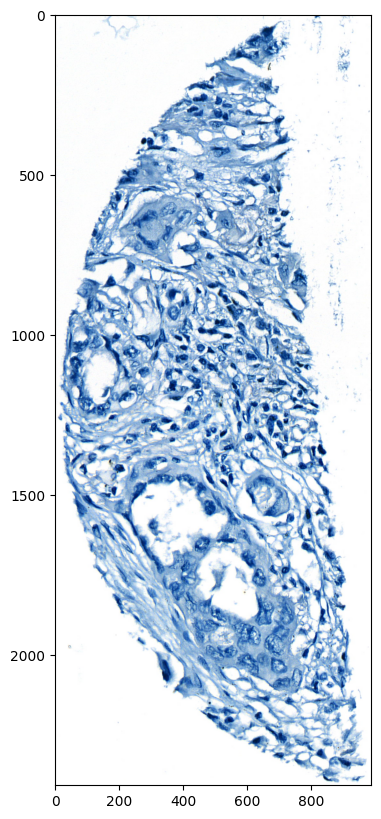

Slide 2, core 135, width 7902, height 5499


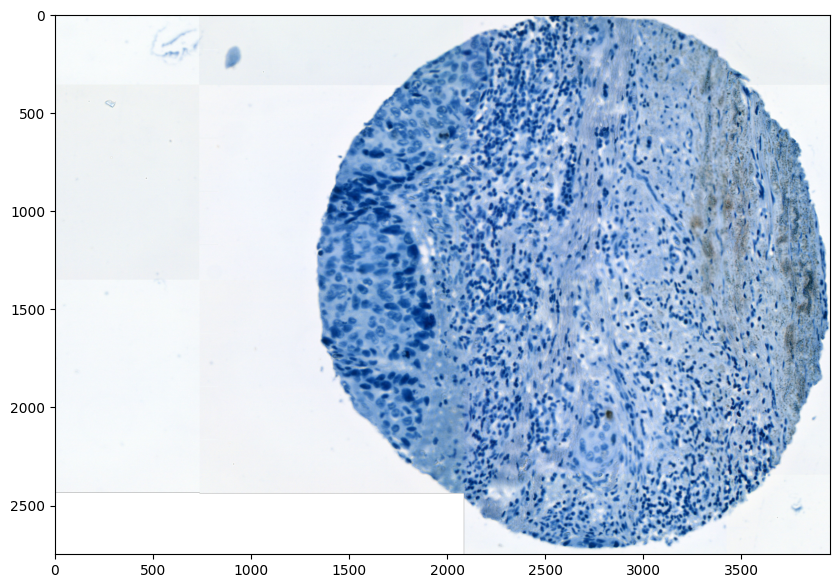

Slide 2, core 195, width 7827, height 5478


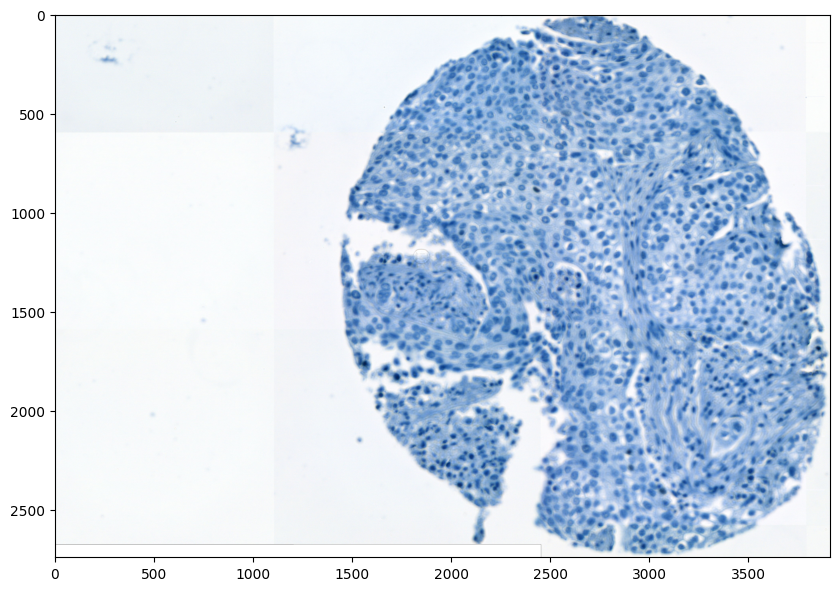

Slide 1, core 559, width 7041, height 7413


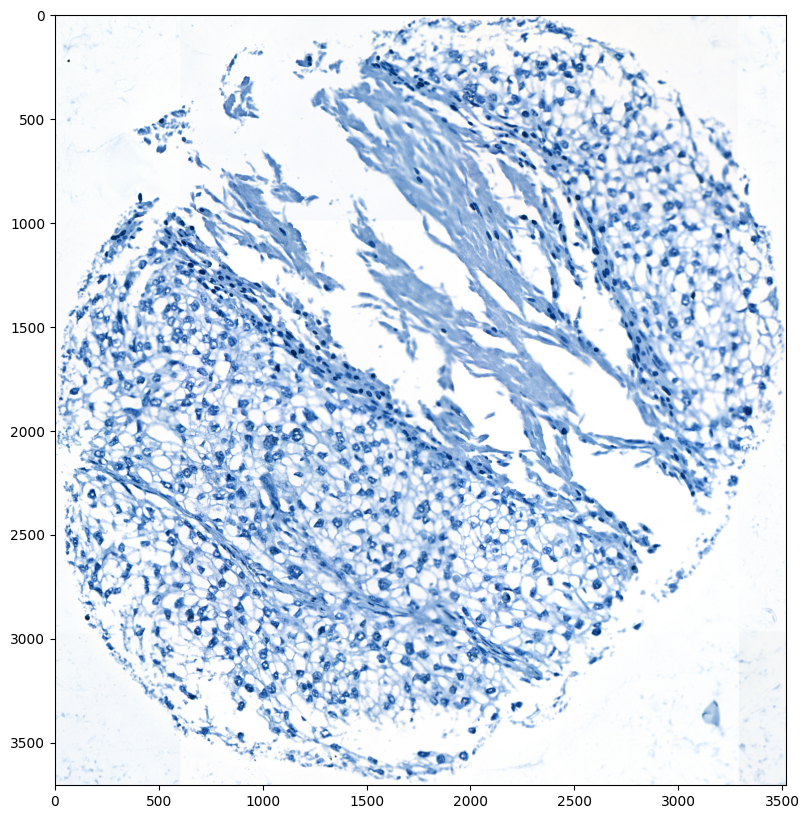

Slide 1, core 566, width 6173, height 7309


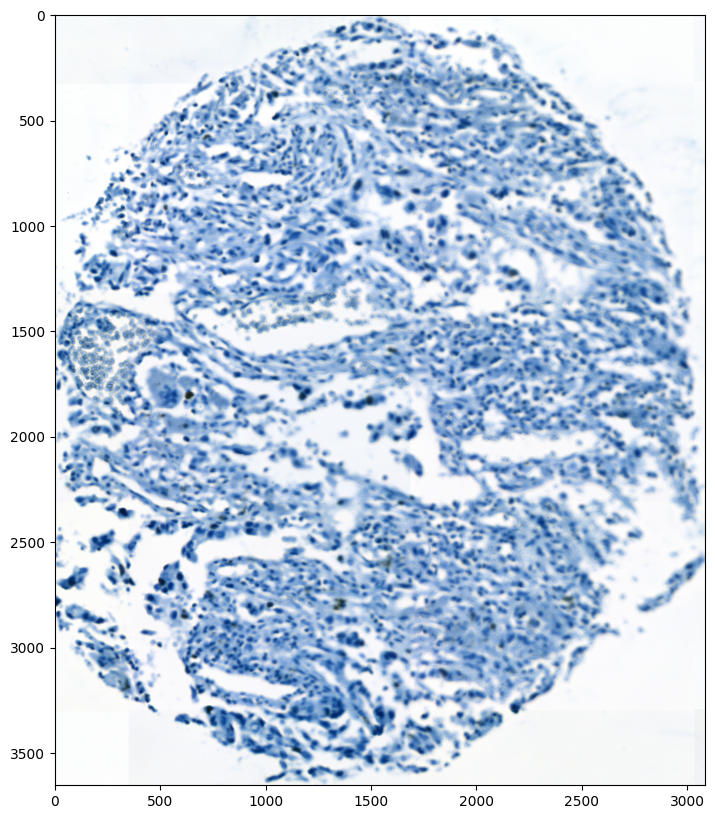

Slide 1, core 574, width 6211, height 7451


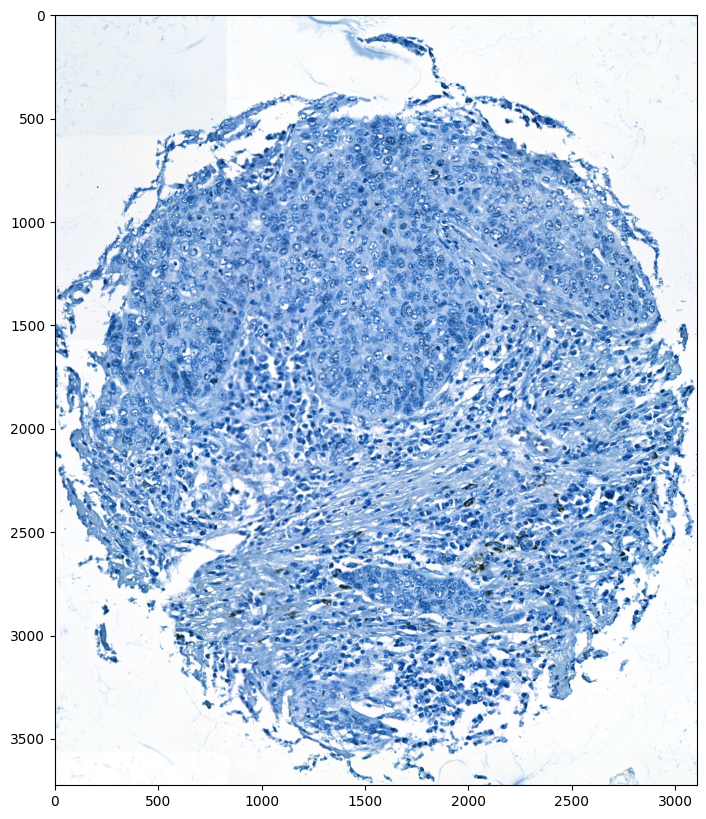

Slide 1, core 576, width 6678, height 7156


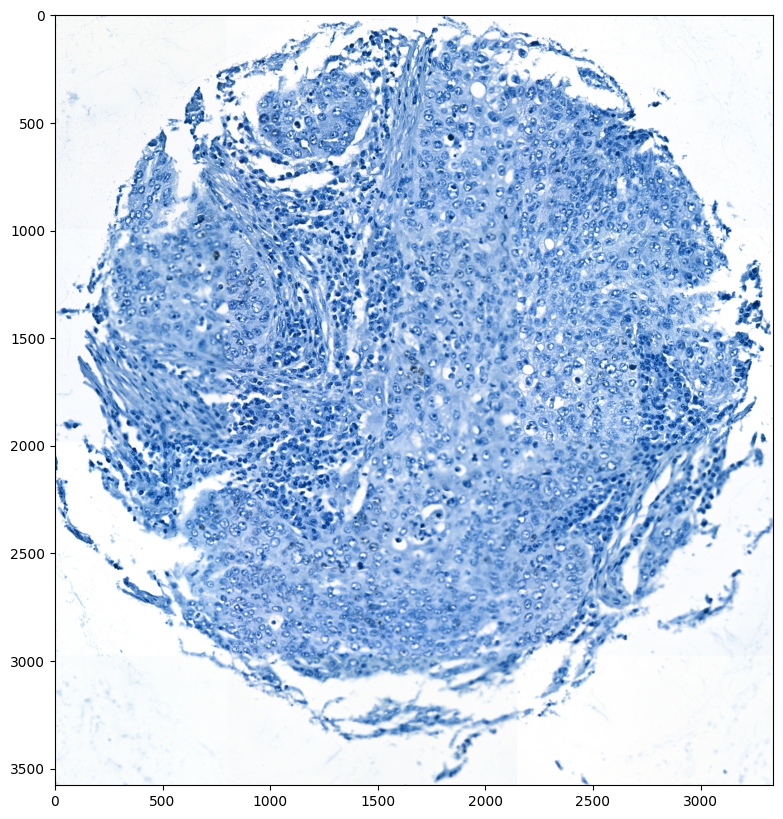

Slide 1, core 592, width 6469, height 7156


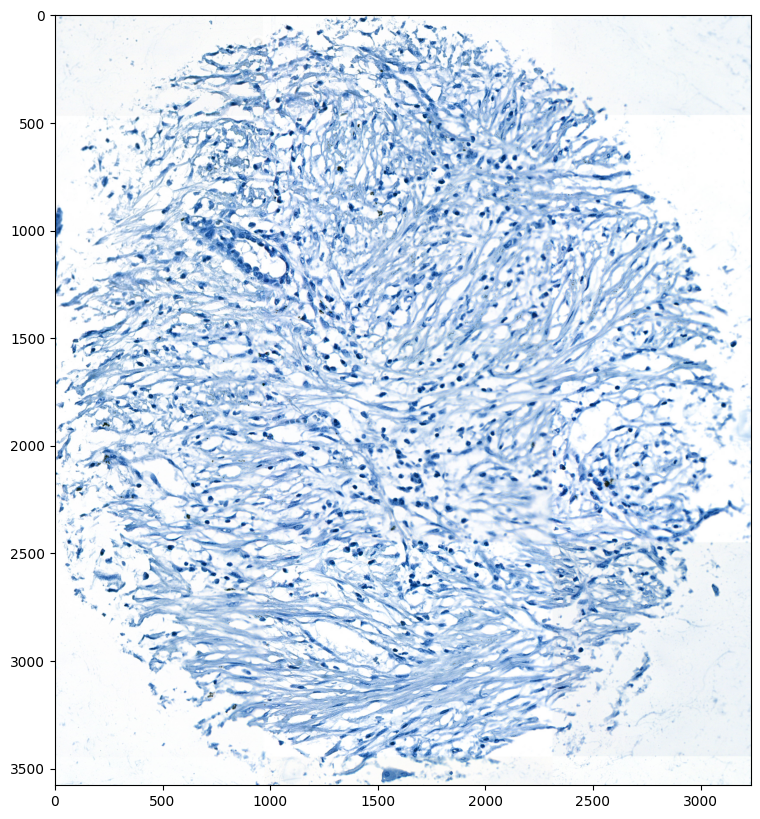

Slide 1, core 597, width 6554, height 7308


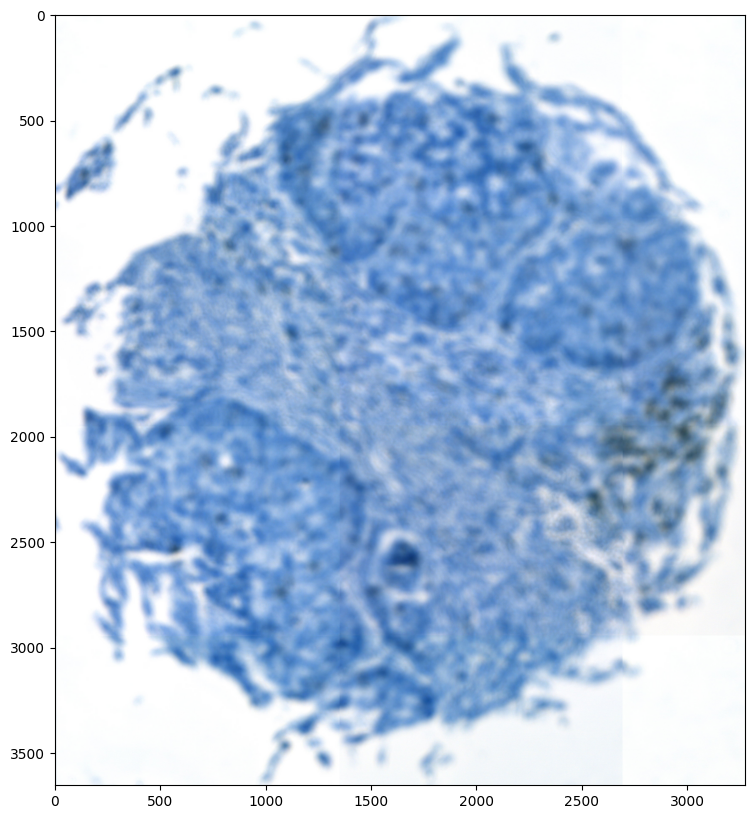

Slide 1, core 604, width 7461, height 7766


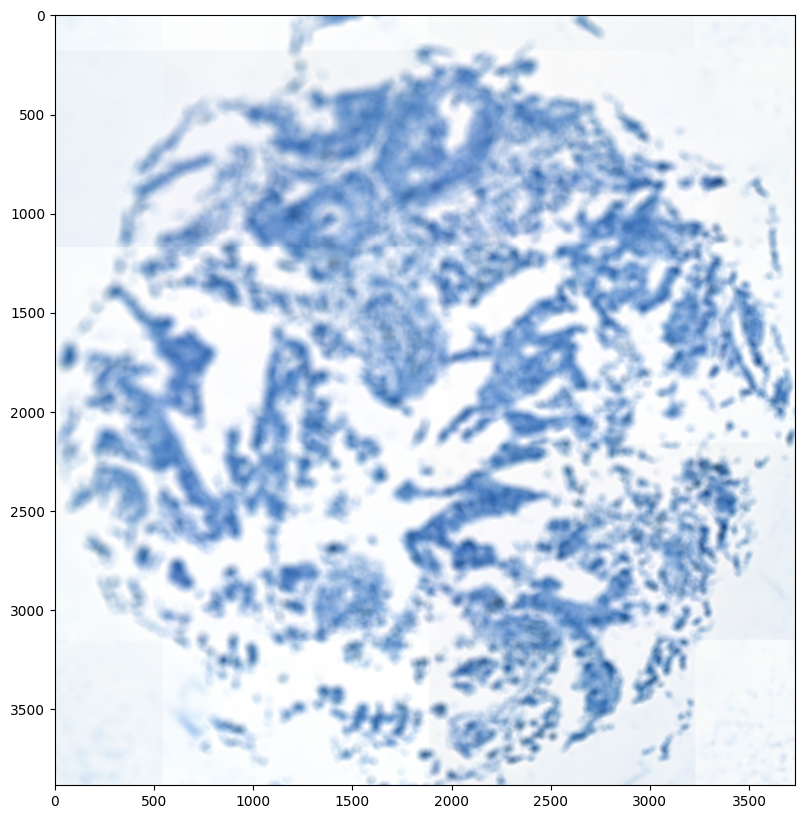

Slide 1, core 607, width 6487, height 7213


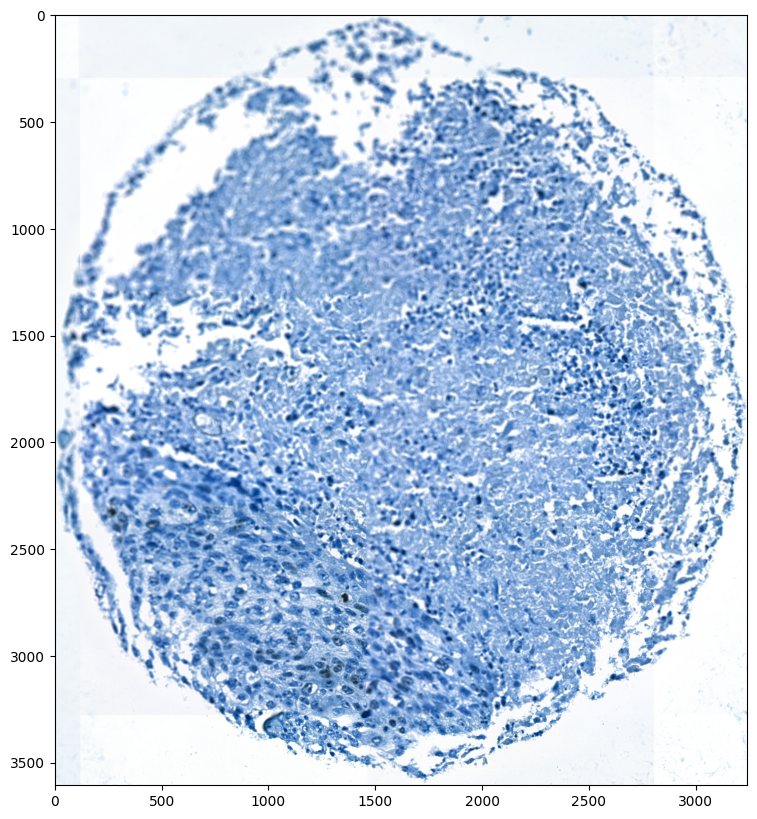

Slide 1, core 615, width 7346, height 7251


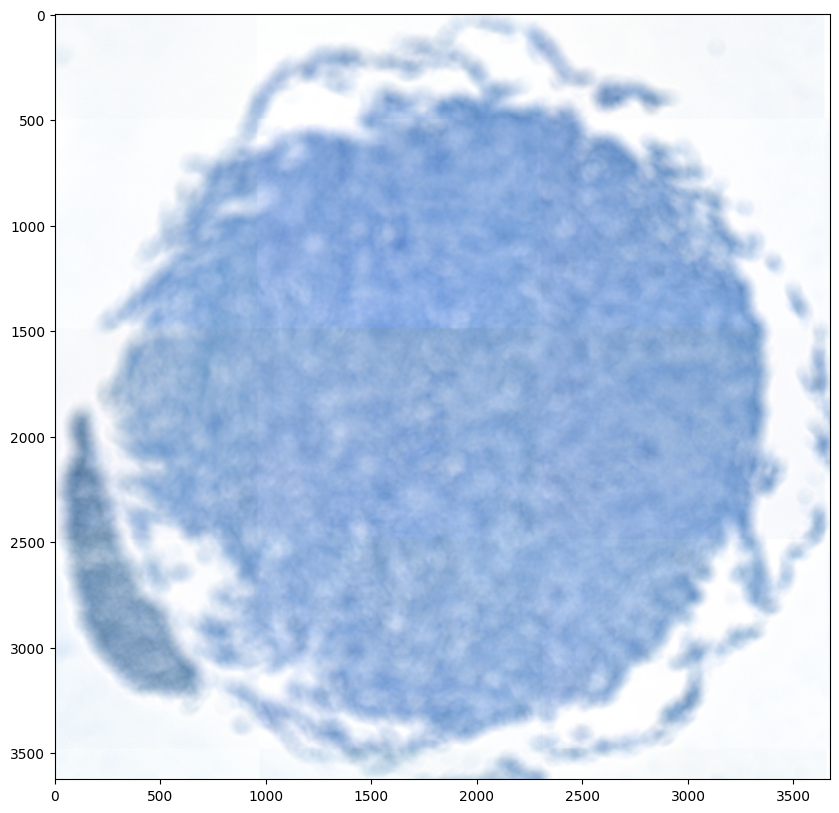

Slide 1, core 619, width 6287, height 7155


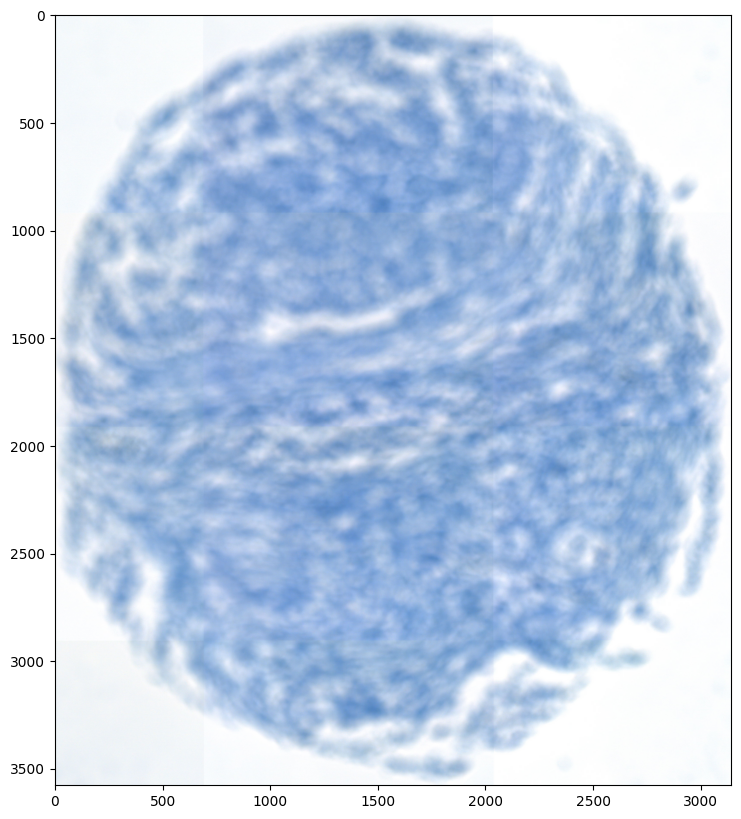

Slide 1, core 632, width 7526, height 6213


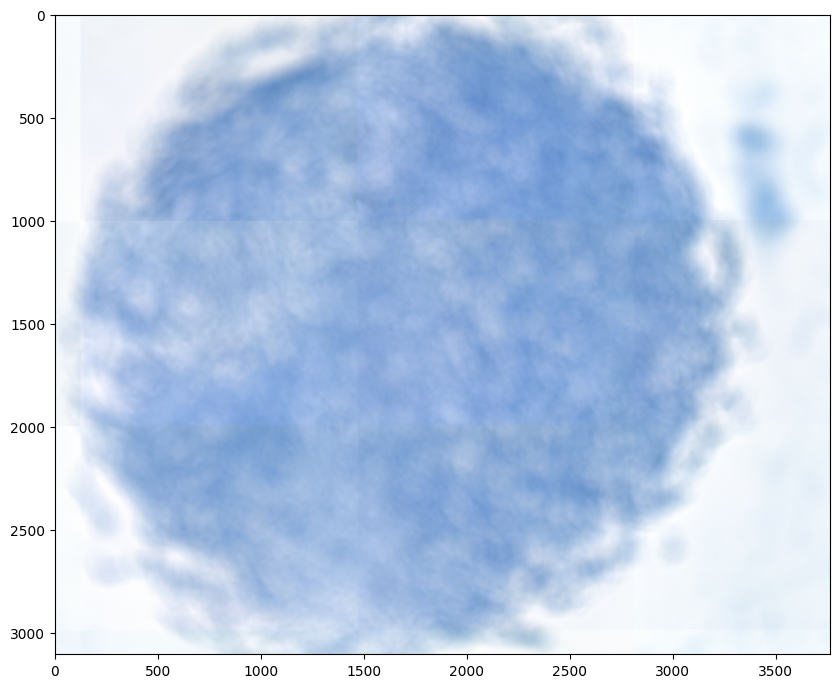

Slide 1, core 634, width 6536, height 7194


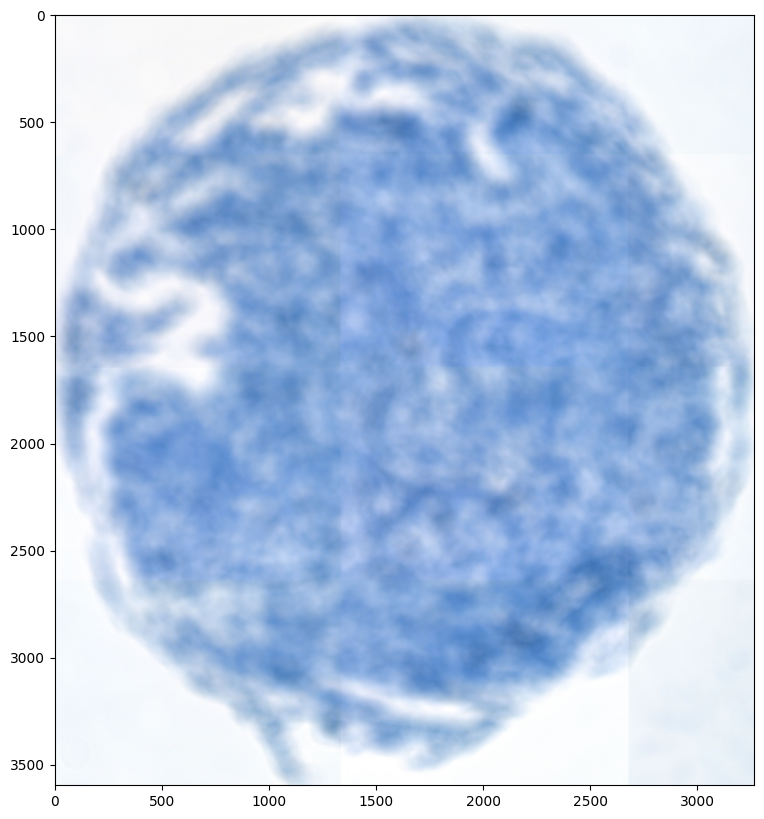

Slide 1, core 637, width 7079, height 7480


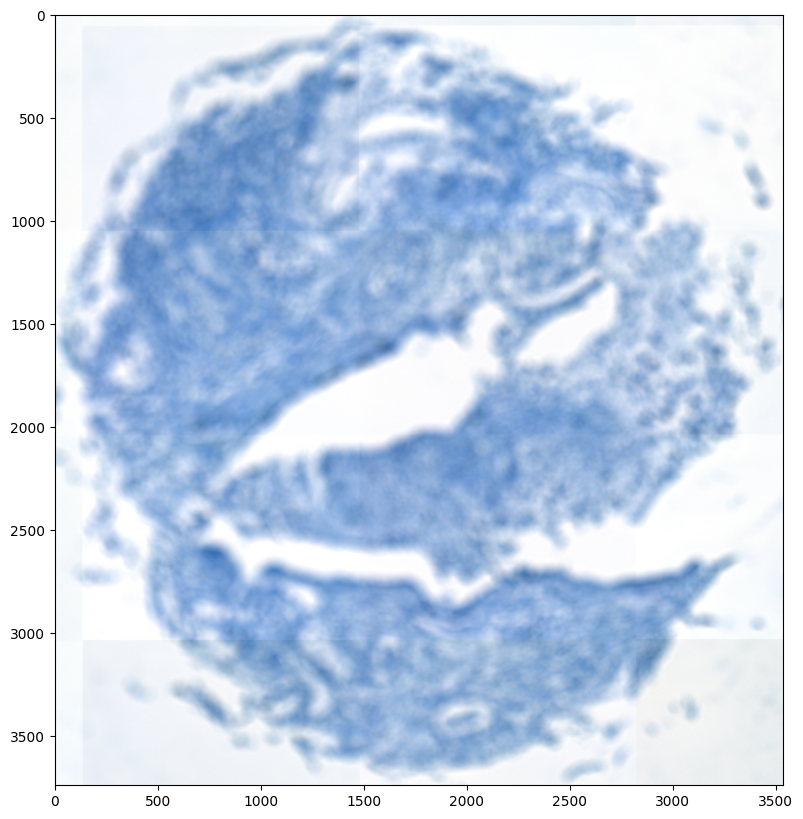

Slide 1, core 648, width 7036, height 7371


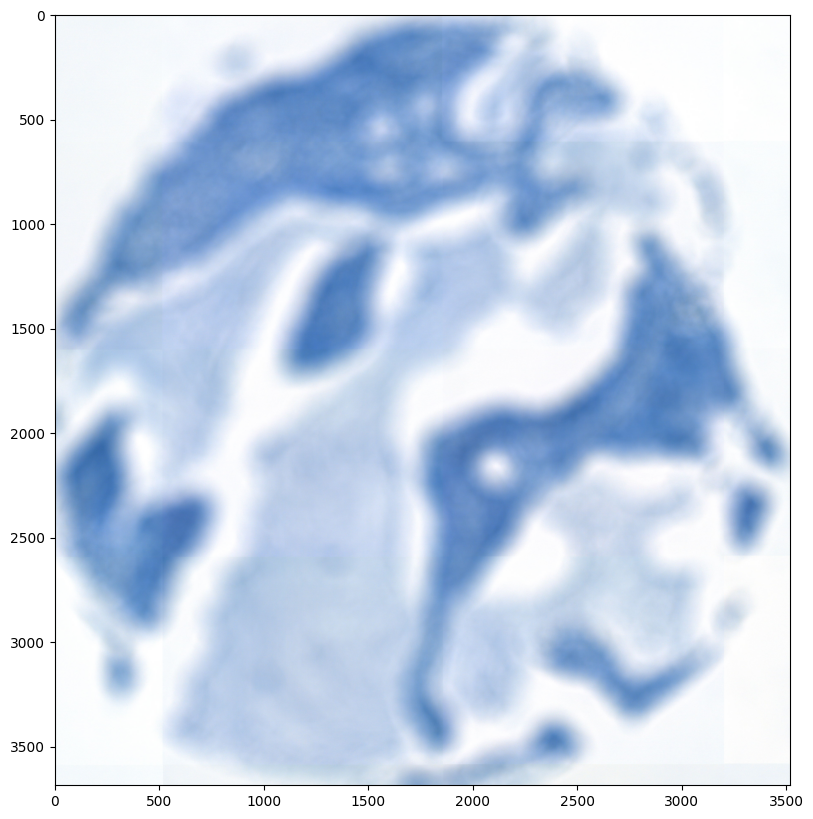

Slide 1, core 651, width 7022, height 6440


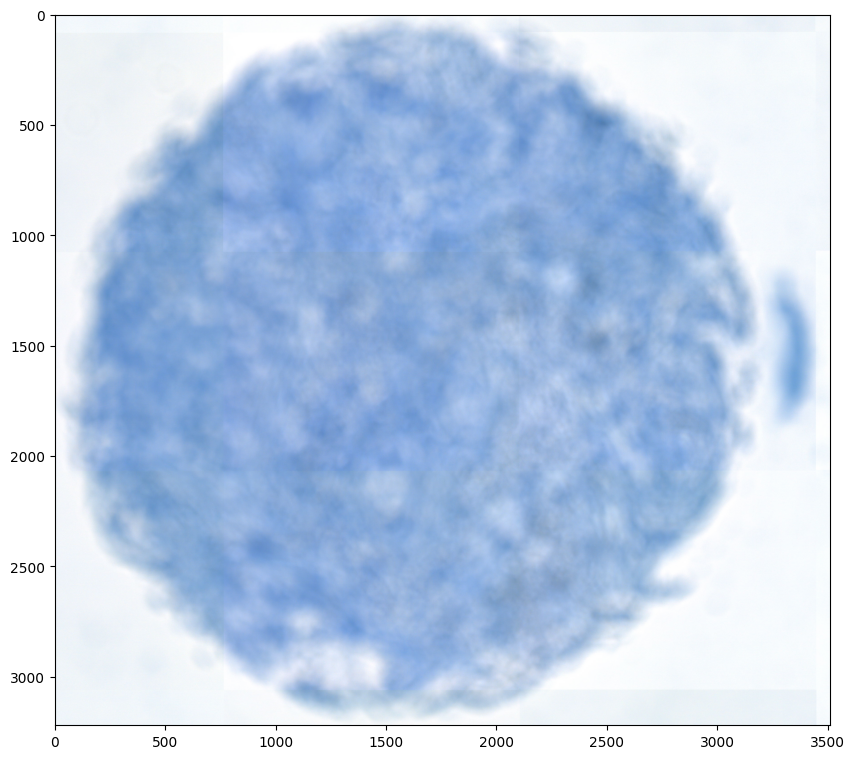

Slide 1, core 698, width 6595, height 7883


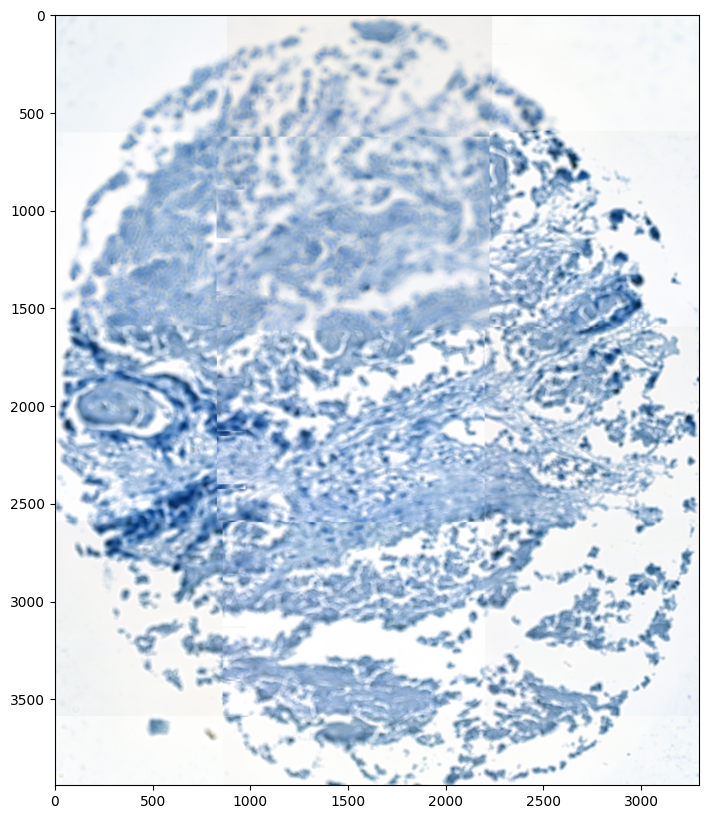

Slide 1, core 721, width 6774, height 7317


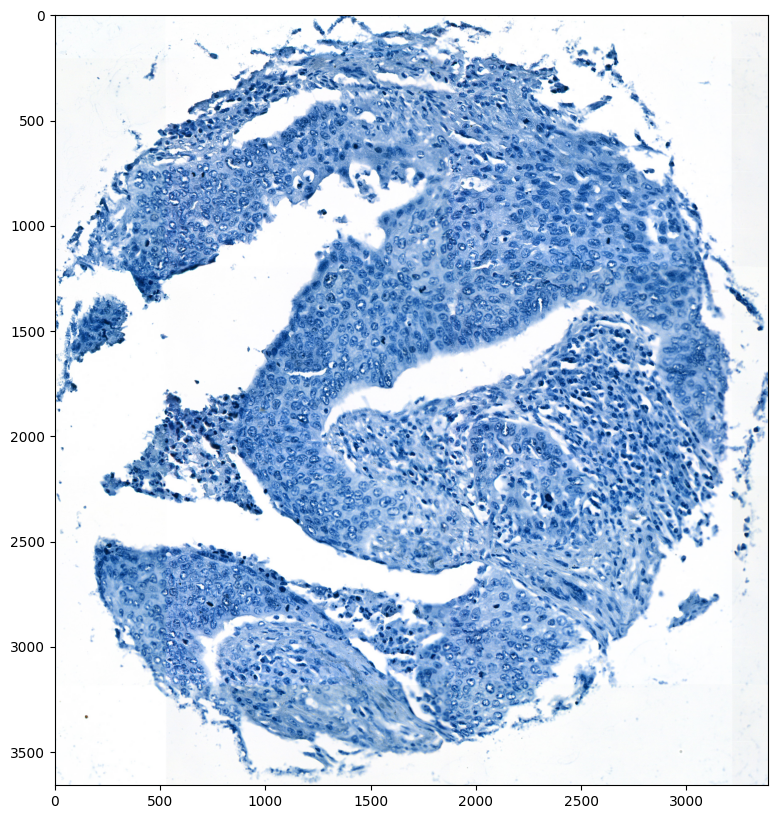

Slide 1, core 723, width 6822, height 7337


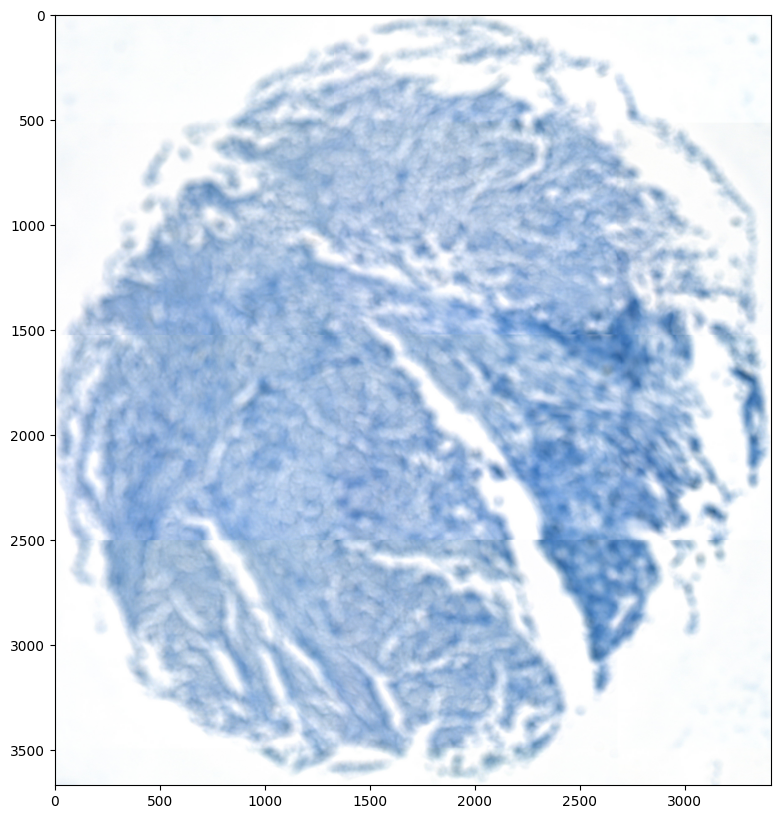

Slide 1, core 748, width 6764, height 7022


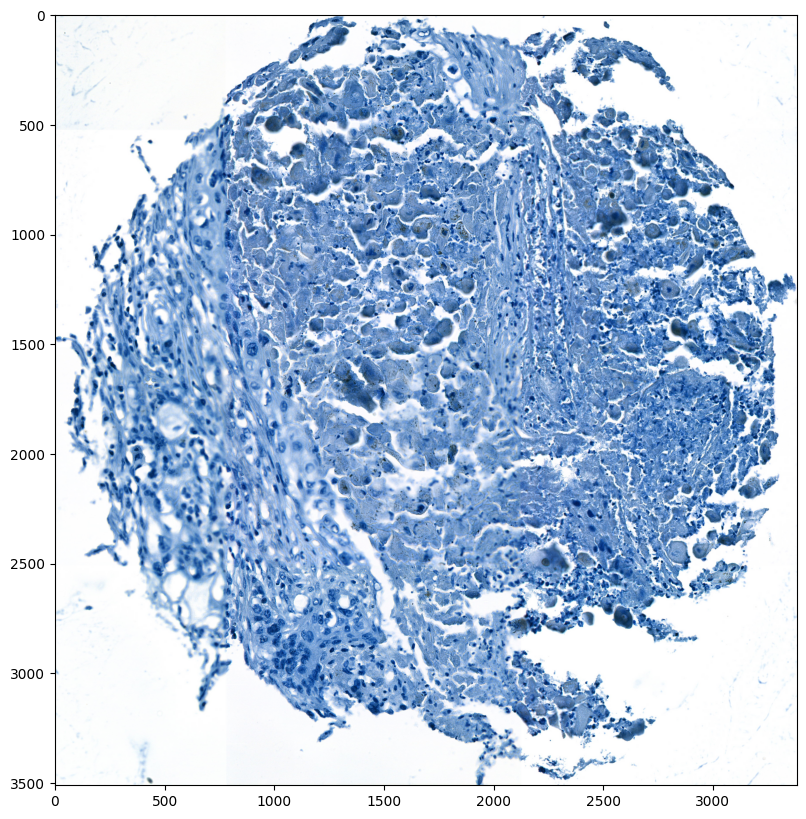

Slide 1, core 758, width 7137, height 7070


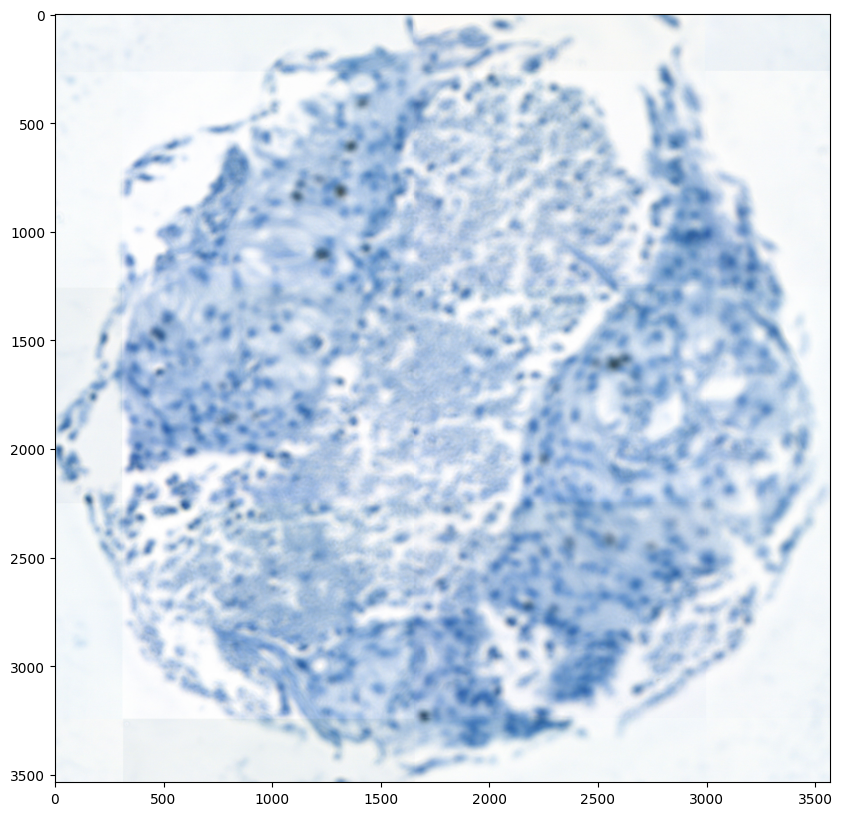

Slide 1, core 762, width 7041, height 6602


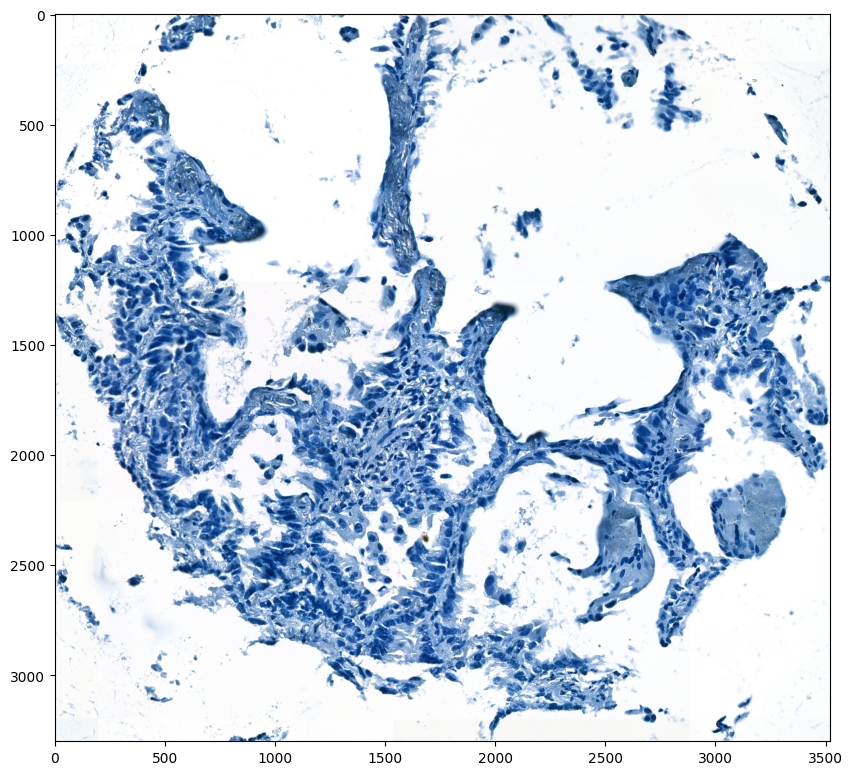

Slide 1, core 789, width 7613, height 7089


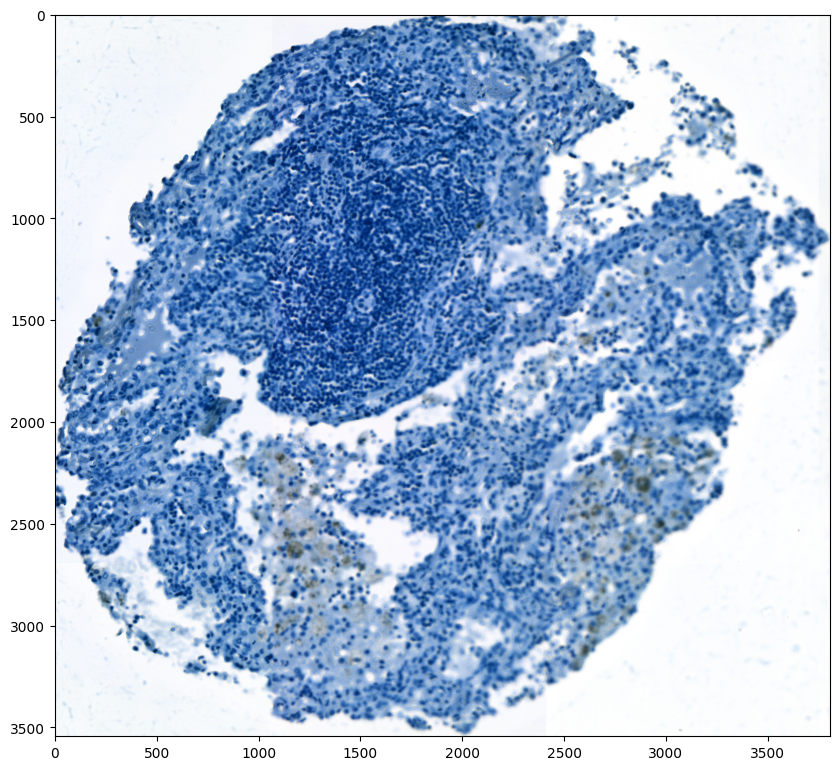

Slide 1, core 829, width 7575, height 7213


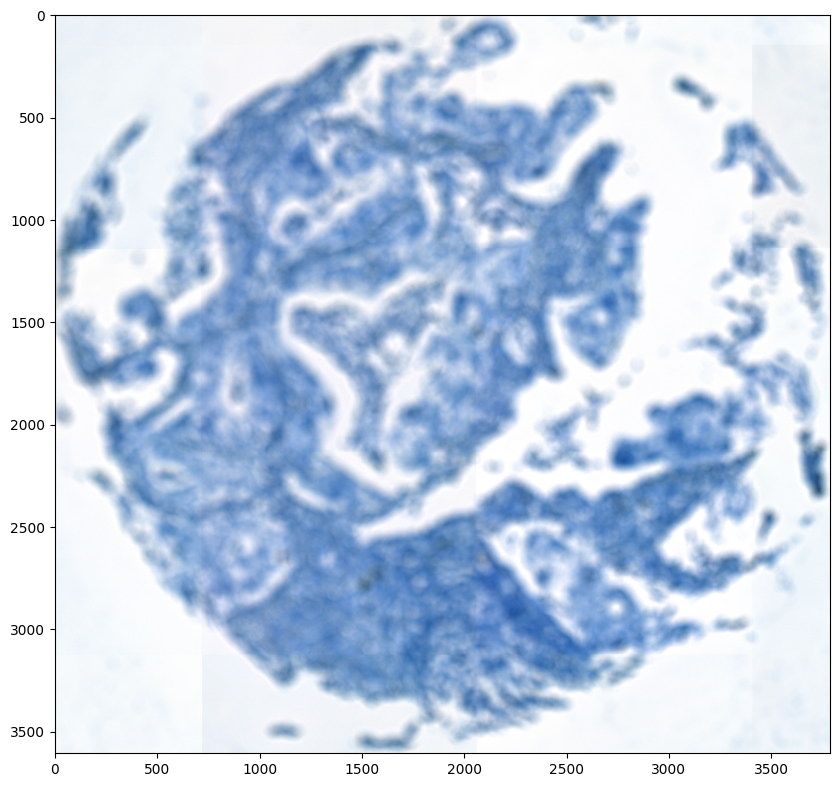

In [17]:
for slide_id in df.slide_id.unique():
    x_range, y_range, too_big, too_small = check_coreID_range(slide_id=slide_id, df=df, min=MIN, max=MAX)
    
    slide_fn = slides.dir[slides.slide_id == slide_id].item() + '/' + slides.filename[slides.slide_id == slide_id].item()
    slide_level = slides.level[slides.slide_id == slide_id].item()
    slide_df = df.loc[df.slide_id == slide_id]

    slide = openslide.open_slide(str(slide_fn))

    if len(too_big) > 0:
        for core_id, x_range, y_range in too_big:
            print('Slide {}, core {}, width {}, height {}'.format(slide_id, core_id, x_range, y_range))
            show_core(slide, slide_df, core_id=core_id, level=slide_level)

    if len(too_small) > 0:
        for core_id, x_range, y_range in too_small:
            print('Slide {}, core {}, width {}, height {}'.format(slide_id, core_id, x_range, y_range))
            show_core(slide, slide_df, core_id=core_id, level=slide_level)
